# Switch CREG12.L75 to both Xarray & Dask for the analyse

In [1]:
import dask_hpcconfig
from distributed import Client
dask_hpcconfig.print_clusters()
clusters = dask_hpcconfig.available_clusters()
clusters

Available clusters:
 • local: local
 • datarmor-local: local
 • datarmor: pbs
 • datarmor-seq: pbs


{'local': 'local',
 'datarmor-local': 'local',
 'datarmor': 'pbs',
 'datarmor-seq': 'pbs'}

In [2]:
memory_size = 25
n_worker_per_node = 115 // memory_size
n_threads_per_worker = 28 // n_worker_per_node
print(n_worker_per_node, n_threads_per_worker)

4 7


In [3]:
overrides = {
#    "cluster.threads_per_worker": n_threads_per_worker,
#    "cluster.n_workers": n_worker_per_node,
}

In [4]:
overrides

{}

In [5]:
cluster = dask_hpcconfig.cluster("datarmor", **overrides)
#cluster = dask_hpcconfig.cluster("datarmor-local", **overrides)  
client = Client(cluster)
client

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


Connection method: Cluster object,Cluster type: dask_jobqueue.PBSCluster
Dashboard: http://10.148.1.47:8787/status,
Dashboard: http://10.148.1.47:8787/status,Workers: 0
Total threads: 0,Total memory: 0 B
Comm: tcp://10.148.1.47:59103,Workers: 0
Dashboard: http://10.148.1.47:8787/status,Total threads: 0
Started: Just now,Total memory: 0 B


In [6]:
cluster.scale(jobs=3)

/home1/datawork/ctalandi/conda-env/Jupyter-Dask/lib/python3.11/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)


In [68]:
import xarray as xr 
import matplotlib.pylab as plt
import numpy as np
import hvplot.xarray
import cartopy.crs as crs

In [69]:
! date 

Tue Dec 12 15:03:36 GMT 2023


In [70]:
from mpl_toolkits.basemap import Basemap
import matplotlib as mpl

def Arc_plot(zlon,zlat,ztab,zcontours,zlim,zmap='Spectral_r',proj='cassi',fld=''): 

    #m = Basemap(projection='npstere',boundinglat=65,lon_0=-20, resolution='l')
    #proj='cassi'
    #proj='gin'
    #proj='cassisva'
    if proj == 'npstere' :
        m = Basemap(projection='npstere',boundinglat=75,lon_0=-140, resolution='l')
    elif proj == 'cassi' :
        m = Basemap(llcrnrlon=-170,llcrnrlat=68,urcrnrlon=-60,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=-140,lat_0=60)  
    elif proj == 'gin' :
        m = Basemap(llcrnrlon=-20,llcrnrlat=60,urcrnrlon=60,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=0,lat_0=65)    
    elif proj == 'cassis_BGZoom' :
        m = Basemap(llcrnrlon=-170,llcrnrlat=68,urcrnrlon=-110,urcrnrlat=80, resolution='i',\
                    projection='cass',lon_0=-140,lat_0=60)    

    
    zfontsize=12
    m.drawparallels(np.arange(-90.,91.,5.),labels=[True,False,True,False], size=zfontsize, linewidth=0.3, alpha=0.5)
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[False,True,False,True], size=zfontsize, latmax=90.,linewidth=0.3,alpha=0.7)
    m.fillcontinents(color='grey')

    norm = mpl.colors.Normalize(vmin=limits[0], vmax=limits[1])

    X,Y = m(zlon,zlat)
    m.contourf(X,Y,ztab,zcontours,cmap=zmap,extend='both')
    cbar=plt.colorbar()
    cbar.set_label(fld, fontsize=12, rotation=270)
    cbar.ax.tick_params(labelsize=10)
    
    #zcontours=np.arange(0.,1000.,100)
    #C=m.contour(X,Y,ztab,levels=zcontours,colors='black',alpha=0.8)
    #plt.clabel(C,C.levels,inline=True,fmt='%.0f',fontsize=15)


In [71]:
def GeoBox(lfig,area='large'):
    props = dict(boxstyle='round', facecolor='y', alpha=1.0)

    if area == 'large' :     
        lfig.text(0.26, 0.17, 'ALASKA', color='k',fontsize=16, bbox=props, alpha=1.)
        lfig.text(0.64, 0.53, 'CANADIAN \n ARCHIPELAGO', color='k',fontsize=16, bbox=props, alpha=1.)
        props = dict(boxstyle='round', facecolor='w', alpha=1.0)
        lfig.text(0.41, 0.87, 'NORTH POLE', color='k',fontsize=16, bbox=props, alpha=1.)

        props = dict(facecolor='w', alpha=1.0)
        lfig.text(0.6, 0.17, 'ANR ImMEDIAT (LOPS)', color='grey',fontsize=16, bbox=props, alpha=1.)
        
    elif area == 'zoom' :
        lfig.text(0.28, 0.24, 'ALASKA', color='k',fontsize=16, bbox=props, alpha=1.)
        lfig.text(0.64, 0.53, 'CANADIAN \n ARCHIPELAGO', color='k',fontsize=16, bbox=props, alpha=1.)
        props = dict(boxstyle='round', facecolor='w', alpha=1.0)
        lfig.text(0.51, 0.8, 'NORTH POLE', color='k',fontsize=16, bbox=props, alpha=1.)
        
        props = dict(facecolor='w', alpha=1.0)
        lfig.text(0.6, 0.24, 'ANR ImMEDIAT (LOPS)', color='grey',fontsize=16, bbox=props, alpha=1.)

# SEDNA grid 

In [72]:
DDIR="/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID"
ds_sedna_bat=xr.open_dataset(DDIR+'/'+'bathymetry_CREG12_V3.3_REF09_20230801.nc')

In [73]:
%%time 
CDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID/'
ds_coord=xr.open_dataset(CDIR+'CREG12.L75-REF09_domain_cfg_20230810_Z.nc',chunks={'t':1 ,'z':15,'y':500, 'x':500})

CPU times: user 132 ms, sys: 24 ms, total: 156 ms
Wall time: 235 ms


In [74]:
ds_coord

<xarray.Dataset>
Dimensions:       (t: 1, y: 1801, x: 1580, z: 75, nlines: 114)
Dimensions without coordinates: t, y, x, z, nlines
Data variables: (12/43)
    bathy_meter   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    bottom_level  (t, y, x) int32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1f           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1t           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1u           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1v           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    ...            ...
    namelist_cfg  (nlines) |S115 dask.array<chunksize=(114,), meta=np.ndarray>
    nav_lat       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lev       (z) float32 dask.array<chunksize=(15,), meta=np.ndarray>
    nav_lon       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    time_counter  (t) float32 dask.array<chunksize=(1,), meta=np.ndarray>
    top_level     (t, y, x) int32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    DOMAIN_number_total:     1
    DOMAIN_number:           0
    DOMAIN_dimensions_ids:   [1 2]
    DOMAIN_size_global:      [1580 1801]
    DOMAIN_size_local:       [1580 1801]
    DOMAIN_position_first:   [1 1]
    DOMAIN_position_last:    [1580 1801]
    DOMAIN_halo_size_start:  [0 0]
    DOMAIN_halo_size_end:    [0 0]
    DOMAIN_type:             BOX
    NCO:                     netCDF Operators version 5.0.1 (Homepage = http:...
    history:                 Mon Aug 14 15:57:07 2023: ncrename -d time_count...

In [75]:
ds_coord=ds_coord.set_coords('nav_lon')
ds_coord=ds_coord.set_coords('nav_lat')
ds_coord=ds_coord.set_coords('nav_lev')

In [76]:
ds_coord

<xarray.Dataset>
Dimensions:       (t: 1, y: 1801, x: 1580, z: 75, nlines: 114)
Coordinates:
    nav_lat       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lev       (z) float32 dask.array<chunksize=(15,), meta=np.ndarray>
    nav_lon       (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
Dimensions without coordinates: t, y, x, z, nlines
Data variables: (12/40)
    bathy_meter   (t, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    bottom_level  (t, y, x) int32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1f           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1t           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1u           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1v           (t, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    ...            ...
    ln_sco        int32 ...
    ln_zco        int32 ...
    ln_zps        int32 ...
    namelist_cfg  (nlines) |S115 dask.array<chunksize=(114,), meta=np.ndarray>
    time_counter  (t) float32 dask.array<chunksize=(1,), meta=np.ndarray>
    top_level     (t, y, x) int32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    DOMAIN_number_total:     1
    DOMAIN_number:           0
    DOMAIN_dimensions_ids:   [1 2]
    DOMAIN_size_global:      [1580 1801]
    DOMAIN_size_local:       [1580 1801]
    DOMAIN_position_first:   [1 1]
    DOMAIN_position_last:    [1580 1801]
    DOMAIN_halo_size_start:  [0 0]
    DOMAIN_halo_size_end:    [0 0]
    DOMAIN_type:             BOX
    NCO:                     netCDF Operators version 5.0.1 (Homepage = http:...
    history:                 Mon Aug 14 15:57:07 2023: ncrename -d time_count...

In [94]:
mfile='CREG12.L75-REF09_mesh_mask_domain_cfg_20230810_Zxrxrxr.nc'
MDIR='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/GRID/'

In [110]:
ds_mesh=xr.open_dataset(MDIR+mfile,chunks={'time_counter':1 ,'nav_lev':15,'yyy':500, 'xxx':500})

In [111]:
ds_mesh

<xarray.Dataset>
Dimensions:       (time_counter: 1, yyy: 1801, xxx: 1580, nav_lev: 75)
Coordinates:
  * nav_lev       (nav_lev) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) float32 0.0
Dimensions without coordinates: yyy, xxx
Data variables: (12/40)
    e1f           (time_counter, yyy, xxx) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1t           (time_counter, yyy, xxx) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1u           (time_counter, yyy, xxx) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1v           (time_counter, yyy, xxx) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e2f           (time_counter, yyy, xxx) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e2t           (time_counter, yyy, xxx) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    ...            ...
    tmask         (time_counter, nav_lev, yyy, xxx) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    tmaskutil     (time_counter, yyy, xxx) int8 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    umask         (time_counter, nav_lev, yyy, xxx) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    umaskutil     (time_counter, yyy, xxx) int8 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    vmask         (time_counter, nav_lev, yyy, xxx) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    vmaskutil     (time_counter, yyy, xxx) int8 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    CfgName:    UNKNOWN
    CfgIndex:   -999
    Iperio:     0
    Jperio:     0
    NFold:      0
    NFtype:     -
    VertCoord:  zps
    IsfCav:     0
    file_name:  mesh_mask.nc
    TimeStamp:  14/08/2023 16:37:07 +0200
    history:    Tue Dec 12 13:48:19 2023: ncks -x -v x,y CREG12.L75-REF09_mes...
    NCO:        "4.6.4"

In [112]:
ds_mesh=ds_mesh.rename_dims({'yyy':'y'})
ds_mesh=ds_mesh.rename_dims({'xxx':'x'})
ds_mesh=ds_mesh.rename_dims({'nav_lev':'deptht'})

In [113]:
ds_mesh=ds_mesh.set_coords('glamt')
ds_mesh=ds_mesh.set_coords('gphit')

In [114]:
ds_mesh=ds_mesh.rename_vars({'glamt':'nav_lon'})
ds_mesh=ds_mesh.rename_vars({'gphit':'nav_lat'})
ds_mesh=ds_mesh.rename_vars({'nav_lev':'deptht'})

In [115]:
ds_mesh.nbytes*1e-9

16.660873604000003

In [116]:
ds_mesh

<xarray.Dataset>
Dimensions:       (time_counter: 1, y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lon       (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
  * deptht        (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) float32 0.0
Dimensions without coordinates: y, x
Data variables: (12/38)
    e1f           (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1t           (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1u           (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e1v           (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e2f           (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    e2t           (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    ...            ...
    tmask         (time_counter, deptht, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    tmaskutil     (time_counter, y, x) int8 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    umask         (time_counter, deptht, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    umaskutil     (time_counter, y, x) int8 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    vmask         (time_counter, deptht, y, x) int8 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    vmaskutil     (time_counter, y, x) int8 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
Attributes:
    CfgName:    UNKNOWN
    CfgIndex:   -999
    Iperio:     0
    Jperio:     0
    NFold:      0
    NFtype:     -
    VertCoord:  zps
    IsfCav:     0
    file_name:  mesh_mask.nc
    TimeStamp:  14/08/2023 16:37:07 +0200
    history:    Tue Dec 12 13:48:19 2023: ncks -x -v x,y CREG12.L75-REF09_mes...
    NCO:        "4.6.4"

# Compute an annual mean EKE  

In [28]:
import glob

In [29]:
DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/*/'

In [30]:
!ls $DATAIN

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/2011/:
CREG12.L75-REF09_2011.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/2012/:
CREG12.L75-REF09_2012.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/2013/:
CREG12.L75-REF09_2013.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/2014/:
CREG12.L75-REF09_2014.1y_EKE.nc

/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/2015/:
CREG12.L75-REF09_2015.1y_EKE.nc


In [31]:
lref=sorted(glob.glob(DATAIN+'CREG12.L75-REF09_201[1-5].1y_EKE.nc'))

# Adding a vertical chunk clearly solve the whole process

In [32]:
%%time 
ds_year=xr.open_mfdataset(lref, chunks={'time_counter':1 ,'deptht':15,'y':500, 'x':500}, engine="netcdf4")
#chunks={'time_counter':1 ,'deptht':1,'y':1300, 'x':1300}, engine="netcdf4")
#,combine='by_coords',concat_dim=["time_counter"],parallel=True)
print('           Size othe yearly EKE dataset :', ds_year.nbytes*1e-9,'GB')

           Size othe yearly EKE dataset : 12.918933540000001 GB
CPU times: user 124 ms, sys: 56 ms, total: 180 ms
Wall time: 666 ms


In [33]:
ds_year

<xarray.Dataset>
Dimensions:       (time_counter: 5, y: 1801, x: 1580, deptht: 75)
Coordinates:
  * deptht        (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) object 2011-07-01 17:00:00 ... 2015-07-01 17...
Dimensions without coordinates: y, x
Data variables:
    nav_lon       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    voeke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    vomke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  1d
    CONFIG:            CREG12.L75
    CASE:              REF09

In [34]:
ds_year=ds_year.set_coords('nav_lon')
ds_year=ds_year.set_coords('nav_lat')

In [35]:
print('           Size othe yearly EKE dataset :', ds_year.nbytes*1e-9,'GB')

           Size othe yearly EKE dataset : 12.918933540000001 GB


In [36]:
ds_year

<xarray.Dataset>
Dimensions:       (time_counter: 5, y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lon       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float32 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
  * deptht        (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
  * time_counter  (time_counter) object 2011-07-01 17:00:00 ... 2015-07-01 17...
Dimensions without coordinates: y, x
Data variables:
    voeke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    vomke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    votke         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
Attributes:
    start_date:        19790101
    output_frequency:  1d
    CONFIG:            CREG12.L75
    CASE:              REF09

In [37]:
%%time 
voeke=xr.DataArray(ds_year['voeke'])
voekemean=voeke.mean('time_counter').compute()

CPU times: user 4.86 s, sys: 1.98 s, total: 6.84 s
Wall time: 19.1 s


In [38]:
%%time 
votke=xr.DataArray(ds_year['votke'])
votkemean=votke.mean('time_counter').compute()

CPU times: user 3.25 s, sys: 1.79 s, total: 5.04 s
Wall time: 9.3 s


In [39]:
%%time 
vomke=xr.DataArray(ds_year['vomke'])
vomkemean=vomke.mean('time_counter').compute()

CPU times: user 3.48 s, sys: 1.8 s, total: 5.28 s
Wall time: 9.39 s


In [60]:
# Create a new Dataset for the mean energy  
if True: 
    ds_yearout=xr.Dataset()
    ds_yearout.coords['nav_lat']=(ds_sedna_bat['nav_lat'])
    ds_yearout.coords['nav_lon']=(ds_sedna_bat['nav_lon'])
    ds_yearout.coords['deptht']=(ds_year['deptht'])
    ds_yearout['voeke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(voekemean)))
    ds_yearout['voeke'].attrs['long_name']='Mean EKE over 2011-2015'
    ds_yearout['voeke'].attrs['units']='m2s-2'

    ds_yearout['votke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(votkemean)))
    ds_yearout['votke'].attrs['long_name']='Mean KE over 2011-2015'
    ds_yearout['votke'].attrs['units']='m2s-2'

    ds_yearout['vomke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(vomkemean)))
    ds_yearout['vomke'].attrs['long_name']='Mean MKE over 2011-2015'
    ds_yearout['vomke'].attrs['units']='m2s-2'          
    DATAOUT='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/'
    if True: ds_yearout.to_netcdf(DATAOUT+'CREG12.L75-REF09_2011-2015.1y_EKE.nc')

HDF5-DIAG: Error detected in HDF5 (1.14.1-2) thread 1:
  #000: H5Fmount.c line 575 in H5F_flush_mounts(): unable to flush mounted file hierarchy
    major: File accessibility
    minor: Unable to flush data from cache
  #001: H5Fmount.c line 537 in H5F__flush_mounts_recurse(): unable to flush file's cached information
    major: File accessibility
    minor: Unable to flush data from cache
  #002: H5Fint.c line 2293 in H5F__flush(): unable to flush file data
    major: Object cache
    minor: Unable to flush data from cache
  #003: H5Fint.c line 2246 in H5F__flush_phase2(): secure from MDC flush failed
    major: Object cache
    minor: Unable to flush data from cache
  #004: H5AC.c line 1239 in H5AC_secure_from_file_flush(): can't disable skip list
    major: Object cache
    minor: Internal error detected
  #005: H5C.c line 2755 in H5C_set_slist_enabled(): slist not empty?
    major: Object cache
    minor: Internal error detected
  #006: H5Fint.c line 2235 in H5F__flush_phase2(): un

In [41]:
ds_yearout

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lon  (y, x) float32 ...
    nav_lat  (y, x) float32 ...
  * deptht   (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Dimensions without coordinates: y, x
Data variables:
    voeke    (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    votke    (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    vomke    (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan

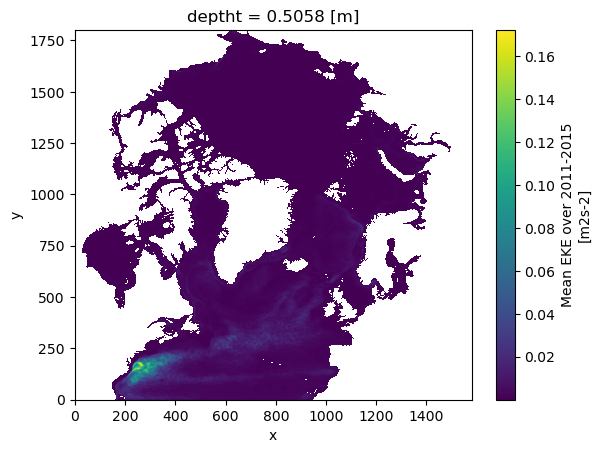

In [42]:
ds_yearout.voeke.isel(deptht=0).plot()

# Compute the log of EKE 

In [85]:
%%time 
if True: 
    DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/'
    ds_meanyear=xr.open_dataset(DATAIN+'CREG12.L75-REF09_2011-2015.1y_EKE.nc',chunks={'nav_lev':10,'y':500, 'x':500}, engine="netcdf4")
    print('           Size othe yearly EKE dataset :', ds_meanyear.nbytes*1e-9,'GB')
else:
    ds_meanyear=ds_yearout

           Size othe yearly EKE dataset : 2.58378694 GB
CPU times: user 28 ms, sys: 12 ms, total: 40 ms
Wall time: 91.4 ms


In [86]:
ds_meanyear

<xarray.Dataset>
Dimensions:  (y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
  * deptht   (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Dimensions without coordinates: y, x
Data variables:
    voeke    (deptht, y, x) float32 dask.array<chunksize=(75, 500, 500), meta=np.ndarray>
    votke    (deptht, y, x) float32 dask.array<chunksize=(75, 500, 500), meta=np.ndarray>
    vomke    (deptht, y, x) float32 dask.array<chunksize=(75, 500, 500), meta=np.ndarray>

# Compute the log of energetics terms

In [64]:
# Compute the log of EKE 
print('           Compute the EKE Log field ')
ds_meanyear['logvotke']=(('deptht','y','x'),np.log10(np.array(ds_meanyear['votke'])))
ds_meanyear['logvomke']=(('deptht','y','x'),np.log10(np.array(ds_meanyear['vomke'])))
ds_meanyear['logvoeke']=(('deptht','y','x'),np.log10(np.array(ds_meanyear['voeke'])))

           Compute the EKE Log field 


In [65]:
ds_meanyear

<xarray.Dataset>
Dimensions:   (y: 1801, x: 1580, deptht: 75)
Coordinates:
    nav_lon   (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat   (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
  * deptht    (deptht) float32 0.5058 1.556 2.668 ... 5.698e+03 5.902e+03
Dimensions without coordinates: y, x
Data variables:
    voeke     (deptht, y, x) float32 dask.array<chunksize=(75, 500, 500), meta=np.ndarray>
    votke     (deptht, y, x) float32 dask.array<chunksize=(75, 500, 500), meta=np.ndarray>
    vomke     (deptht, y, x) float32 dask.array<chunksize=(75, 500, 500), meta=np.ndarray>
    logvotke  (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    logvomke  (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan
    logvoeke  (deptht, y, x) float32 nan nan nan nan nan ... nan nan nan nan nan

In [66]:
%%time 
# Create a new Dataset for the mean energy  
if False: 
    ds_yearout=xr.Dataset()
    ds_yearout.coords['nav_lat']=(ds_sedna_bat['nav_lat'])
    ds_yearout.coords['nav_lon']=(ds_sedna_bat['nav_lon'])
    ds_yearout.coords['deptht']=(ds_meanyear['deptht'])
    ds_yearout['logvoeke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(ds_meanyear['logvoeke'])))
    ds_yearout['logvoeke'].attrs['long_name']='Mean Log10 EKE over 2011-2015'
    ds_yearout['logvoeke'].attrs['units']='m2s-2'

    ds_yearout['logvotke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(ds_meanyear['logvotke'])))
    ds_yearout['logvotke'].attrs['long_name']='Mean Log10 KE over 2011-2015'
    ds_yearout['logvotke'].attrs['units']='m2s-2'

    ds_yearout['logvomke']=(('deptht','y','x'),xr.where(np.array(ds_mesh['tmask'][0,:,:,:]) == 0.,np.nan,np.array(ds_meanyear['logvomke'])))
    ds_yearout['logvomke'].attrs['long_name']='Mean Log10 MKE over 2011-2015'
    ds_yearout['logvomke'].attrs['units']='m2s-2' 
    DATAOUT='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/'
    if True: ds_yearout.to_netcdf(DATAOUT+'CREG12.L75-REF09_2011-2015.1y_LogEKE.nc')

CPU times: user 3.5 s, sys: 4.16 s, total: 7.66 s
Wall time: 7.74 s


# Compute the vertical integral as the ratio EKE/KE MKE/KE as well 

In [117]:
# Only keep the first 200m depth
ds_mesh=ds_mesh.where(ds_mesh['deptht'] <= 200., drop=True)
ds_mesh

<xarray.Dataset>
Dimensions:       (time_counter: 1, y: 1801, x: 1580, deptht: 31)
Coordinates:
    nav_lon       (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
    nav_lat       (time_counter, y, x) float64 dask.array<chunksize=(1, 500, 500), meta=np.ndarray>
  * deptht        (deptht) float32 0.5058 1.556 2.668 ... 163.2 180.5 199.8
  * time_counter  (time_counter) float32 0.0
Dimensions without coordinates: y, x
Data variables: (12/38)
    e1f           (time_counter, y, x, deptht) float64 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    e1t           (time_counter, y, x, deptht) float64 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    e1u           (time_counter, y, x, deptht) float64 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    e1v           (time_counter, y, x, deptht) float64 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    e2f           (time_counter, y, x, deptht) float64 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    e2t           (time_counter, y, x, deptht) float64 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    ...            ...
    tmask         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    tmaskutil     (time_counter, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    umask         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    umaskutil     (time_counter, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
    vmask         (time_counter, deptht, y, x) float32 dask.array<chunksize=(1, 15, 500, 500), meta=np.ndarray>
    vmaskutil     (time_counter, y, x, deptht) float32 dask.array<chunksize=(1, 500, 500, 31), meta=np.ndarray>
Attributes:
    CfgName:    UNKNOWN
    CfgIndex:   -999
    Iperio:     0
    Jperio:     0
    NFold:      0
    NFtype:     -
    VertCoord:  zps
    IsfCav:     0
    file_name:  mesh_mask.nc
    TimeStamp:  14/08/2023 16:37:07 +0200
    history:    Tue Dec 12 13:48:19 2023: ncks -x -v x,y CREG12.L75-REF09_mes...
    NCO:        "4.6.4"

In [88]:
ds_meanyear=ds_meanyear.where(ds_meanyear['deptht'] <= 200., drop=True)
ds_meanyear

<xarray.Dataset>
Dimensions:  (deptht: 31, y: 1801, x: 1580)
Coordinates:
    nav_lon  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
    nav_lat  (y, x) float32 dask.array<chunksize=(500, 500), meta=np.ndarray>
  * deptht   (deptht) float32 0.5058 1.556 2.668 3.856 ... 163.2 180.5 199.8
Dimensions without coordinates: y, x
Data variables:
    voeke    (deptht, y, x) float32 dask.array<chunksize=(31, 500, 500), meta=np.ndarray>
    votke    (deptht, y, x) float32 dask.array<chunksize=(31, 500, 500), meta=np.ndarray>
    vomke    (deptht, y, x) float32 dask.array<chunksize=(31, 500, 500), meta=np.ndarray>

In [118]:
%%time 
Zintvoeke=(ds_meanyear['voeke'][:,:,:]*ds_mesh['e3t_0'][0,:,:,:]).sum(dim='deptht').compute()

CPU times: user 1.26 s, sys: 164 ms, total: 1.43 s
Wall time: 2.58 s


In [119]:
%%time 
Zintvotke=(ds_meanyear['votke'][:,:,:]*ds_mesh['e3t_0'][0,:,:,:]).sum(dim='deptht').compute()

CPU times: user 1.22 s, sys: 164 ms, total: 1.38 s
Wall time: 2.38 s


In [120]:
%%time 
Zintvomke=(ds_meanyear['vomke'][:,:,:]*ds_mesh['e3t_0'][0,:,:,:]).sum(dim='deptht').compute()

CPU times: user 1.29 s, sys: 176 ms, total: 1.46 s
Wall time: 2.77 s


In [121]:
%%time 
doDS=True
if doDS: 
    ds_EKEDiags=xr.Dataset()
    ds_EKEDiags.coords['nav_lat']=(ds_sedna_bat['nav_lat'])
    ds_EKEDiags.coords['nav_lon']=(ds_sedna_bat['nav_lon'])
    ds_EKEDiags['Zintvoeke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.log10(np.array(Zintvoeke))))
    ds_EKEDiags['Zintvoeke'].attrs['long_name']='Mean Log10 EKE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvoeke'].attrs['units']='m3s-2'

    ds_EKEDiags['Zintvotke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.log10(np.array(Zintvotke))))
    ds_EKEDiags['Zintvotke'].attrs['long_name']='Mean Log10 KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvotke'].attrs['units']='m3s-2'

    ds_EKEDiags['Zintvomke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.log10(np.array(Zintvomke))))
    ds_EKEDiags['Zintvomke'].attrs['long_name']='Mean Log10 MKE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['Zintvomke'].attrs['units']='m3s-2'

    ds_EKEDiags['RmkeOke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvomke/Zintvotke)))
    ds_EKEDiags['RmkeOke'].attrs['long_name']='Ratio MKE/KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['RmkeOke'].attrs['units']='%'

    ds_EKEDiags['RekeOke']=(('y','x'),xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0.,np.nan,np.array(Zintvoeke/Zintvotke)))
    ds_EKEDiags['RekeOke'].attrs['long_name']='Ratio EKE/KE (2011-2015) vertically integrated over 200m'
    ds_EKEDiags['RekeOke'].attrs['units']='%'
    
    DATAOUT='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/'    
    if True: ds_EKEDiags.to_netcdf(DATAIN+'CREG12.L75-REF09_2011-2015.1y_LogZintEKE.nc')

<timed exec>:6: RuntimeWarning: divide by zero encountered in log10
<timed exec>:10: RuntimeWarning: divide by zero encountered in log10
<timed exec>:14: RuntimeWarning: divide by zero encountered in log10


CPU times: user 956 ms, sys: 180 ms, total: 1.14 s
Wall time: 1.67 s


# Plot EKE maps @ surface, 81m & 147m 

CPU times: user 2.04 s, sys: 1.18 s, total: 3.22 s
Wall time: 3.24 s


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean EKE \n @ surface')

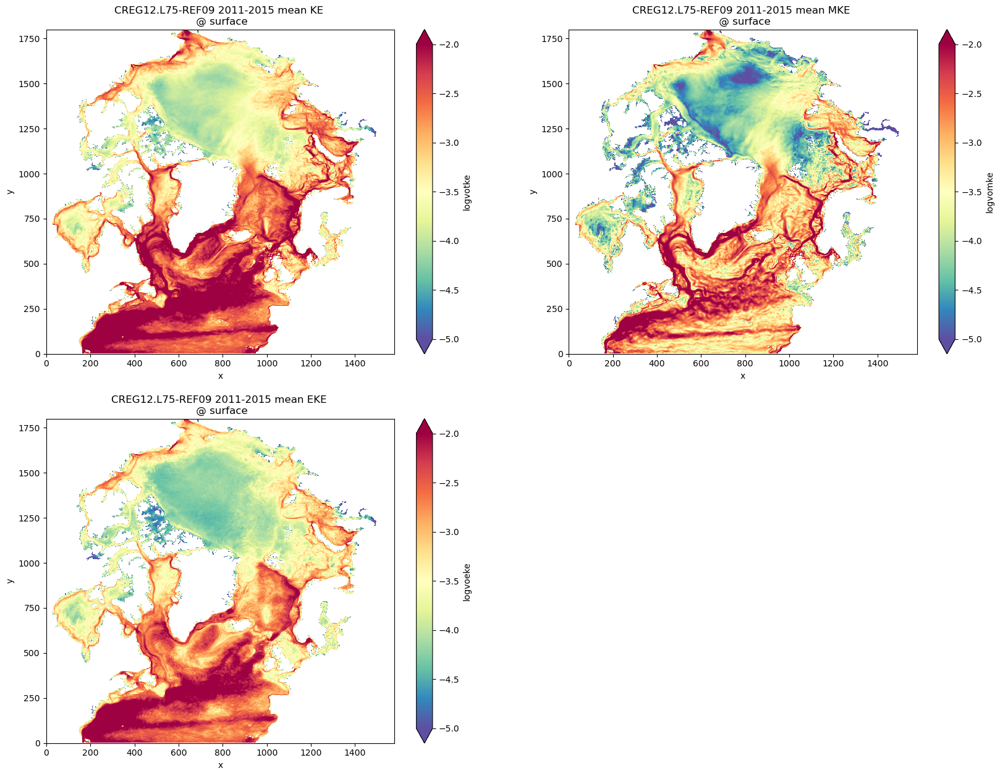

In [48]:
%%time 
plt.figure(figsize=(20,15))
plt.subplot(221)
plot1=xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvotke']).isel(nav_lev=0).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean KE \n @ surface')

plt.subplot(222)
plot2=xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvomke']).isel(nav_lev=0).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean MKE \n @ surface')

plt.subplot(223)
plot3=xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvoeke']).isel(nav_lev=0).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean EKE \n @ surface')

CPU times: user 1.98 s, sys: 1.07 s, total: 3.05 s
Wall time: 2.9 s


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean EKE \n @ depth 81m')

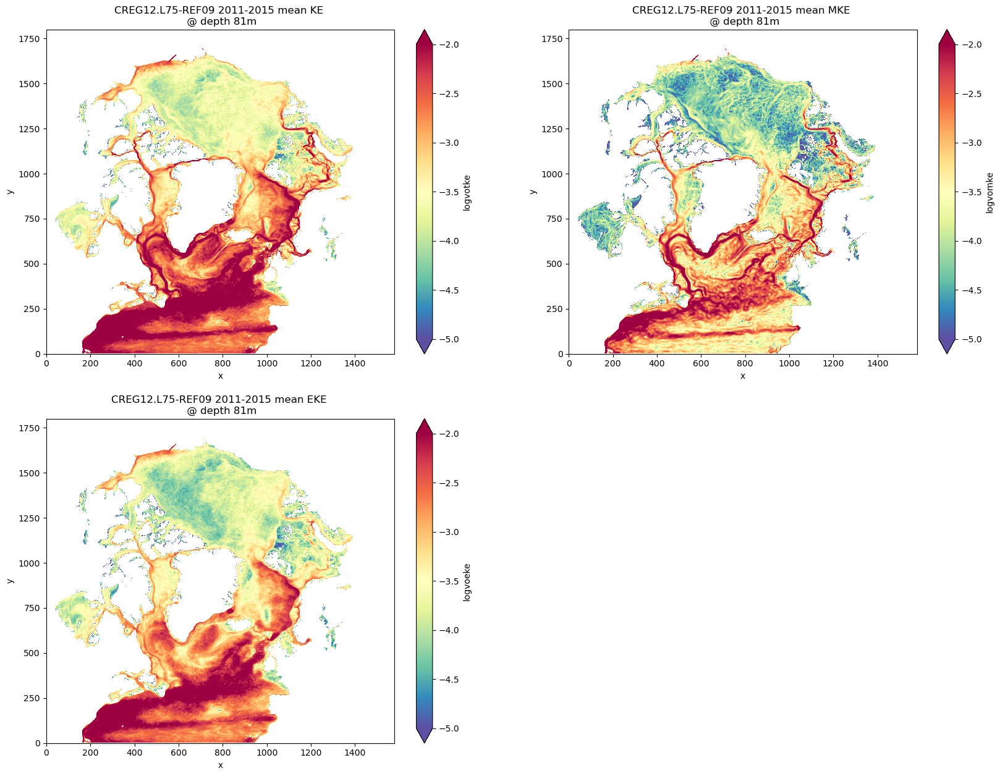

In [49]:
%%time 
plt.figure(figsize=(20,15))
plt.subplot(221)
xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvotke']).isel(nav_lev=21).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean KE \n @ depth 81m')

plt.subplot(222)
xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvomke']).isel(nav_lev=21).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean MKE \n @ depth 81m')

plt.subplot(223)
xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvoeke']).isel(nav_lev=21).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean EKE \n @ depth 81m')


CPU times: user 2.25 s, sys: 1.05 s, total: 3.3 s
Wall time: 3.13 s


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean EKE \n @ depth 147m')

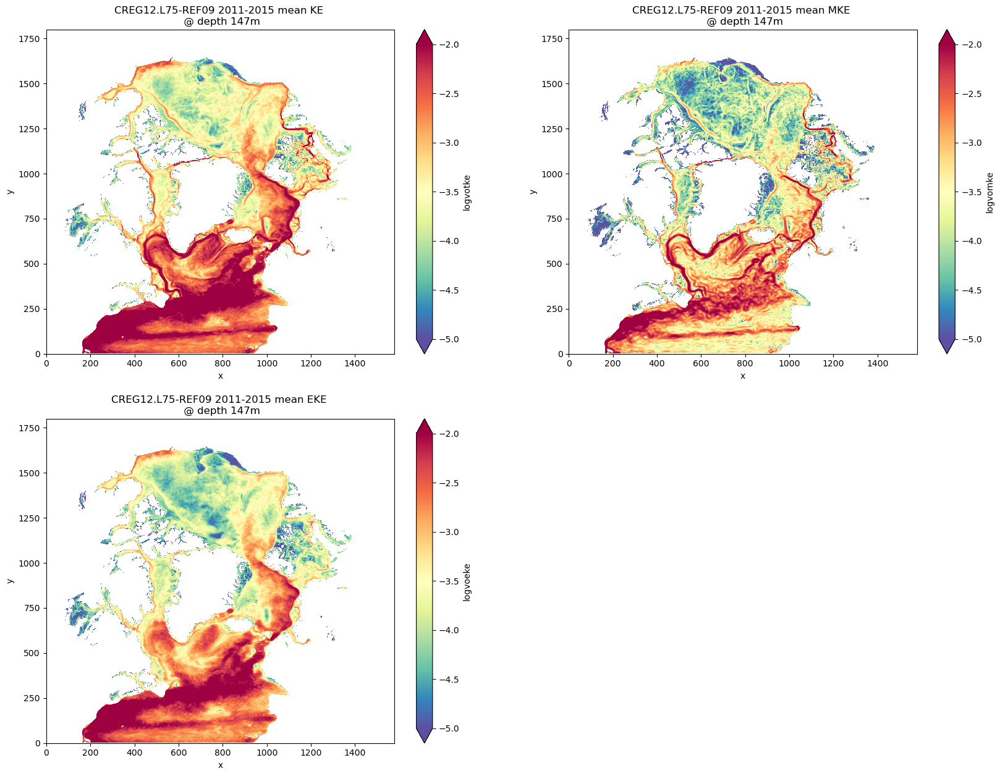

In [50]:
%%time 
plt.figure(figsize=(20,15))
plt.subplot(221)
xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvotke']).isel(nav_lev=27).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean KE \n @ depth 147m')

plt.subplot(222)
xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvomke']).isel(nav_lev=27).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean MKE \n @ depth 147m')

plt.subplot(223)
xr.where(np.array(ds_mesh['tmask'][0,0,:,:]) == 0., np.nan, ds_meanyear['logvoeke']).isel(nav_lev=27).plot(cmap='Spectral_r',vmin=-5.,vmax=-2)
plt.title('CREG12.L75-REF09 2011-2015 mean EKE \n @ depth 147m')


# Plot the ratio EKE/KE & MKE/EKE @ surface, 81m & 147m 

CPU times: user 1.06 s, sys: 648 ms, total: 1.71 s
Wall time: 1.54 s


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n @ surface')

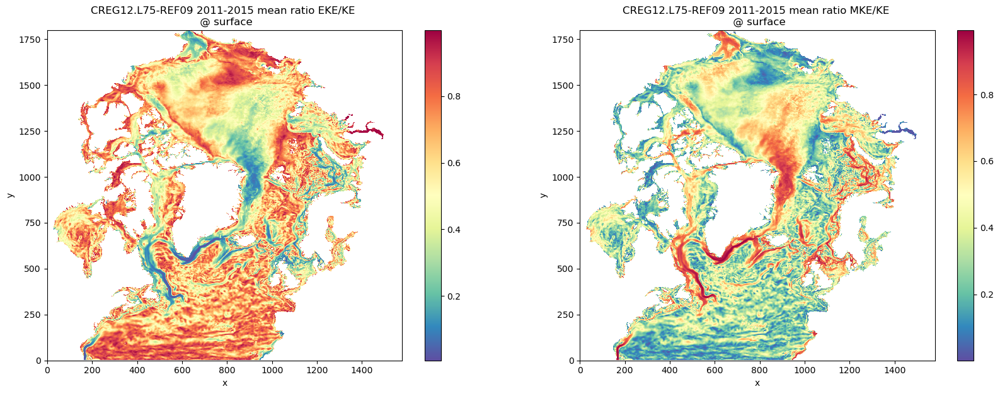

In [51]:
%%time 
plt.figure(figsize=(20,15))
plt.subplot(221)
(ds_meanyear['voeke']/ds_meanyear['votke']).isel(deptht=0).plot(cmap='Spectral_r')
plt.title('CREG12.L75-REF09 2011-2015 mean ratio EKE/KE \n @ surface')

plt.subplot(222)
(ds_meanyear['vomke']/ds_meanyear['votke']).isel(deptht=0).plot(cmap='Spectral_r')
plt.title('CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n @ surface')


CPU times: user 1.04 s, sys: 668 ms, total: 1.71 s
Wall time: 1.55 s


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n @ depth: 81 m')

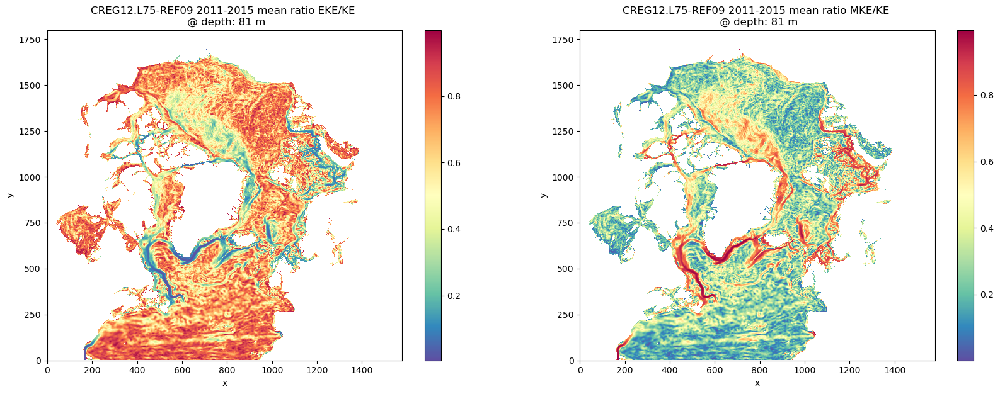

In [52]:
%%time 
plt.figure(figsize=(20,15))
plt.subplot(221)
(ds_meanyear['voeke']/ds_meanyear['votke']).isel(deptht=21).plot(cmap='Spectral_r')
plt.title('CREG12.L75-REF09 2011-2015 mean ratio EKE/KE \n @ depth: 81 m')

plt.subplot(222)
(ds_meanyear['vomke']/ds_meanyear['votke']).isel(deptht=21).plot(cmap='Spectral_r')
plt.title('CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n @ depth: 81 m')

CPU times: user 1.05 s, sys: 640 ms, total: 1.69 s
Wall time: 1.54 s


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n @ depth: 147 m')

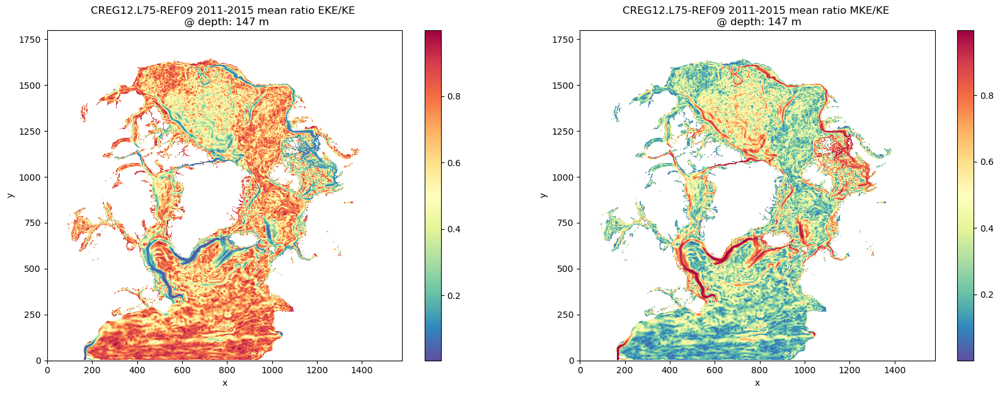

In [53]:
%%time 
plt.figure(figsize=(20,15))
plt.subplot(221)
(ds_meanyear['voeke']/ds_meanyear['votke']).isel(deptht=27).plot(cmap='Spectral_r')
plt.title('CREG12.L75-REF09 2011-2015 mean ratio EKE/KE \n @ depth: 147 m')

plt.subplot(222)
(ds_meanyear['vomke']/ds_meanyear['votke']).isel(deptht=27).plot(cmap='Spectral_r')
plt.title('CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n @ depth: 147 m')

# Plot the vertical integration over 200m for KE, EKE & MKE   

CPU times: user 344 ms, sys: 44 ms, total: 388 ms
Wall time: 400 ms


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean KE \n vertically integrated over 200m')

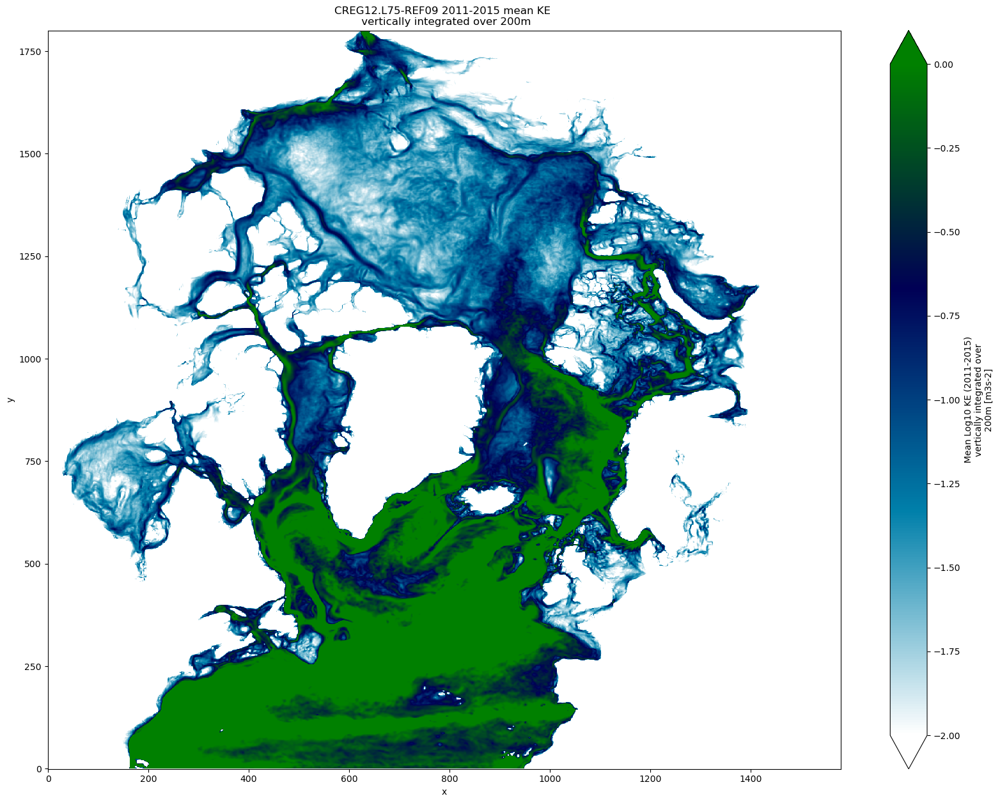

In [122]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvotke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF09 2011-2015 mean KE \n vertically integrated over 200m')

CPU times: user 340 ms, sys: 32 ms, total: 372 ms
Wall time: 327 ms


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 yearly mean MKE \n vertically integrated over 200m')

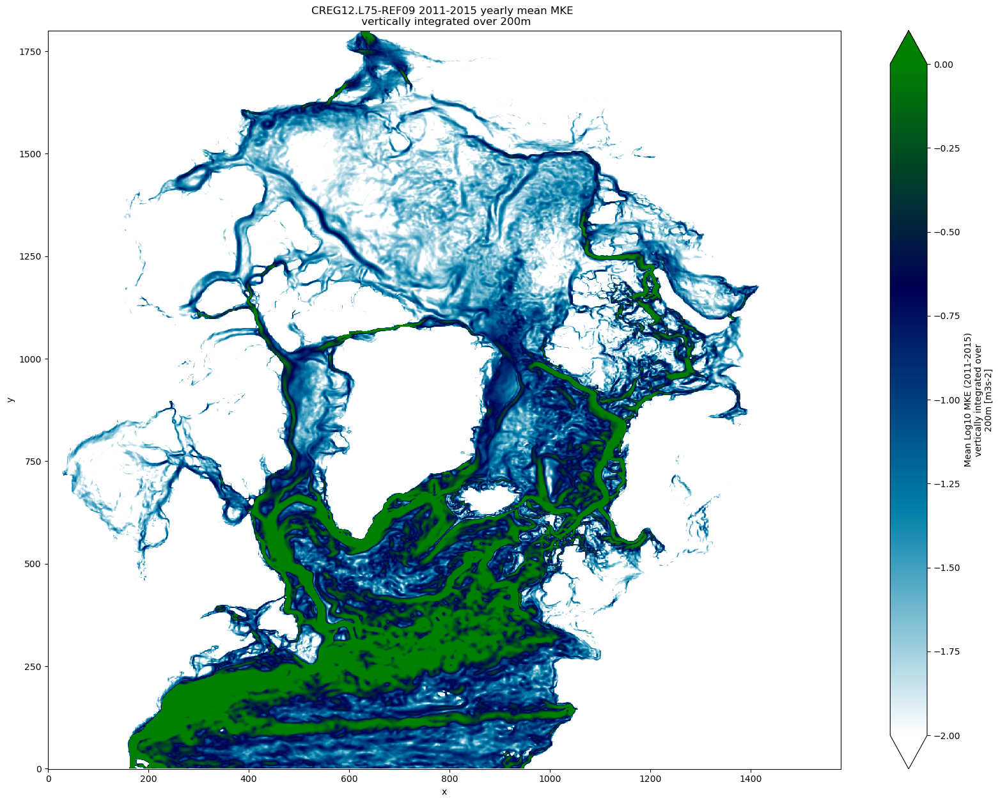

In [123]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvomke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF09 2011-2015 yearly mean MKE \n vertically integrated over 200m')

CPU times: user 332 ms, sys: 20 ms, total: 352 ms
Wall time: 329 ms


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean EKE \n vertically integrated over 200m')

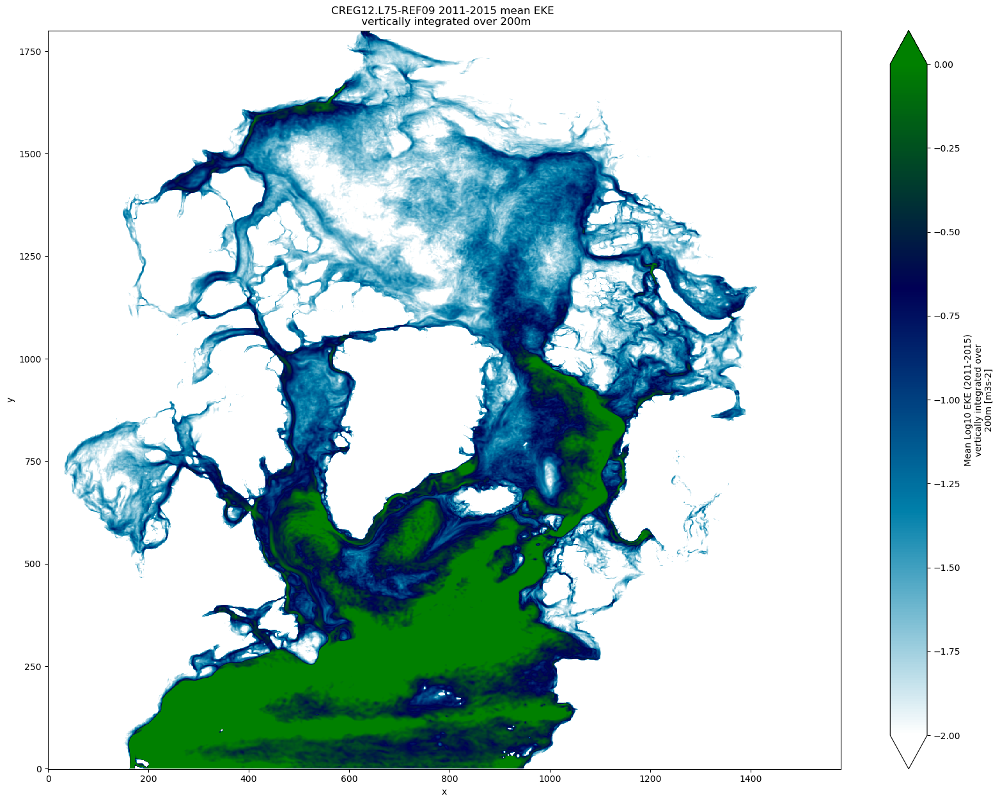

In [124]:
%%time 
plt.figure(figsize=(20,15))
ds_EKEDiags.Zintvoeke.plot(cmap='ocean_r',vmin=-2., vmax=0.)
plt.title('CREG12.L75-REF09 2011-2015 mean EKE \n vertically integrated over 200m')

# Plot the ratio EKE/TKE

In [20]:
%%time
if False:
    DATAIN='/home/datawork-lops-drakkarcom/SIMULATION-OUTPUTS/FREDY/CONFIGS/CREG12.L75/CREG12.L75-REF09-MEAN/DIAGS/EKE/1y/'    
    ds_EKEDiags=xr.open_dataset(DATAIN+'CREG12.L75-REF09_2011-2015.1y_LogZintEKE.nc')

CPU times: user 24 ms, sys: 12 ms, total: 36 ms
Wall time: 179 ms


CPU times: user 328 ms, sys: 40 ms, total: 368 ms
Wall time: 338 ms


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean ratio EKE/KE \n vertically integrated over 200m')

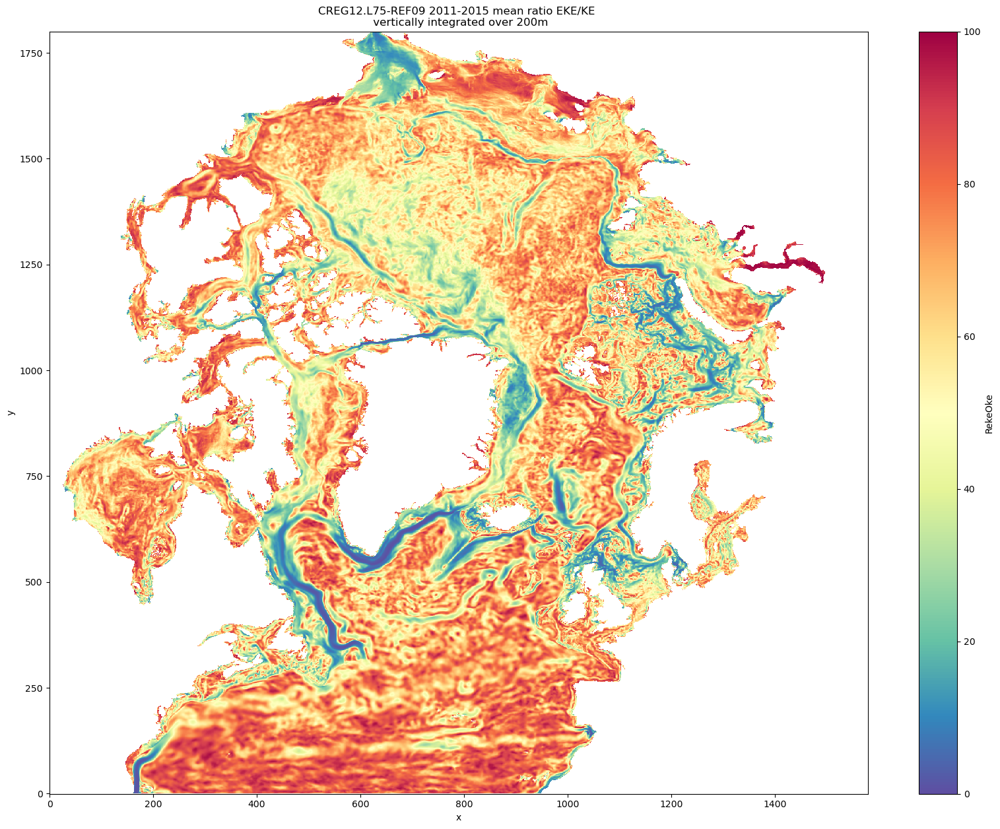

In [125]:
%%time 
plt.figure(figsize=(20,15))
(ds_EKEDiags.RekeOke*100.).plot(cmap='Spectral_r',vmin=0., vmax=100.)
plt.title('CREG12.L75-REF09 2011-2015 mean ratio EKE/KE \n vertically integrated over 200m')

CPU times: user 332 ms, sys: 36 ms, total: 368 ms
Wall time: 329 ms


Text(0.5, 1.0, 'CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n vertically integrated over 200m')

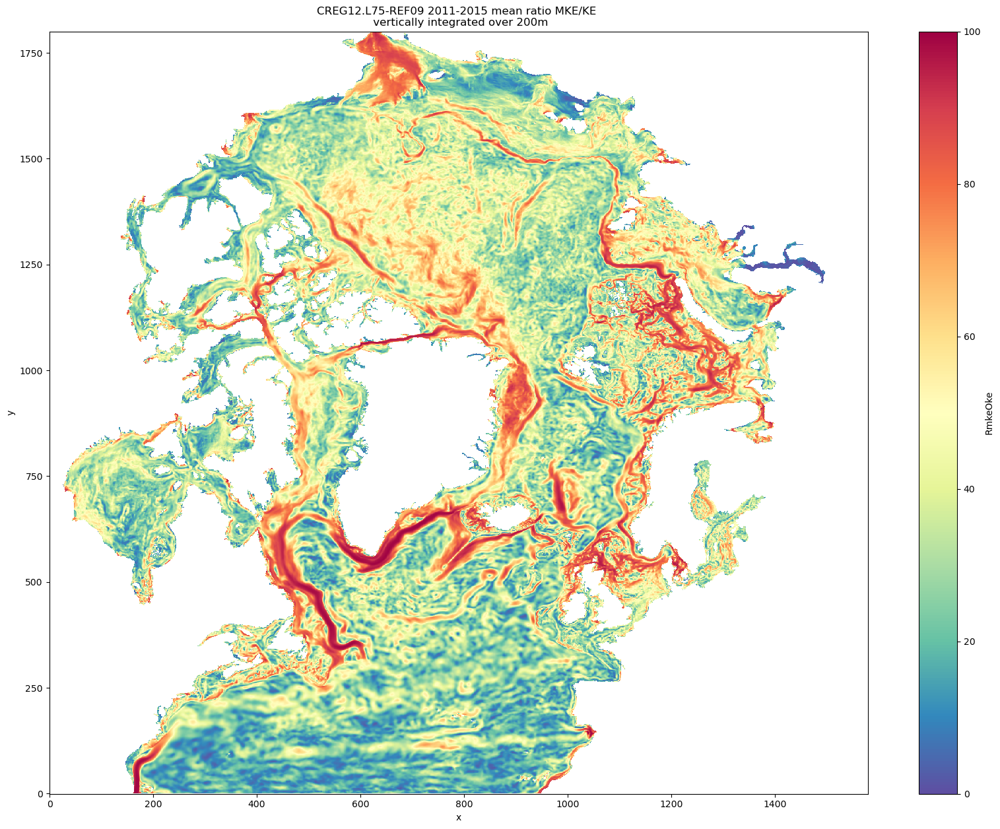

In [126]:
%%time 
plt.figure(figsize=(20,15))
(ds_EKEDiags.RmkeOke*100.).plot(cmap='Spectral_r',vmin=0., vmax=100.)
plt.title('CREG12.L75-REF09 2011-2015 mean ratio MKE/KE \n vertically integrated over 200m')

In [29]:
client.close()
cluster.close()

type: name 'client' is not defined

# PLOT TESTING - PLOT TESTING 

In [24]:
ds_yearout=xr.open_dataset(DATAIN+'SEDNA-DELTA_2011-2015.1y_LogEKE.nc')

In [27]:
ds_yearout.coords['nav_lev']=(ds_mesh['nav_lev'])

In [28]:
ds_yearout

<xarray.Dataset>
Dimensions:   (y: 6540, x: 6560, nav_lev: 57)
Coordinates:
    nav_lon   (y, x) float64 ...
    nav_lat   (y, x) float64 ...
  * nav_lev   (nav_lev) float32 0.4915 1.526 2.63 3.804 ... 181.8 188.0 194.3
Dimensions without coordinates: y, x
Data variables:
    logvoeke  (nav_lev, y, x) float32 ...
    logvotke  (nav_lev, y, x) float32 ...
    logvomke  (nav_lev, y, x) float32 ...

CPU times: user 25.5 s, sys: 2.42 s, total: 27.9 s
Wall time: 27.6 s


<Figure size 640x480 with 0 Axes>

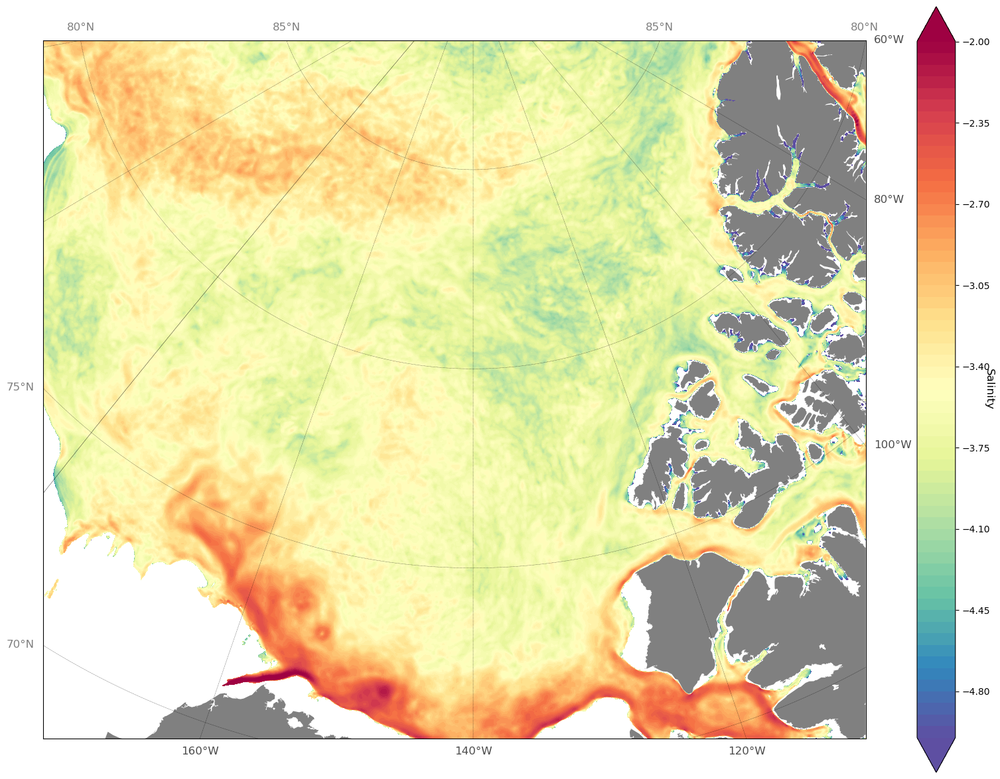

In [30]:
%%time
plt.clf()
vmin=-5. ; vmax=-2. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_yearout['nav_lon']),np.array(ds_yearout['nav_lat']), \
         #ds_alpha_S['vosaline'][0,54,:,:], contours, limits, zmap='Spectral_r',proj='cassi')
         #xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1,np.nan,ds_alpha_S['vosaline'][0,54,:,:]), \
         ds_yearout.logvoeke.sel(nav_lev=81,method='nearest'), \
         contours, limits, zmap='Spectral_r',proj='cassi',fld='Salinity')

#GeoBox(fig)

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_S_z181m_'+ext+'.png',dpi=250)

>>> # Plot a zoom of the Beaufort Gyre

<Figure size 432x288 with 0 Axes>

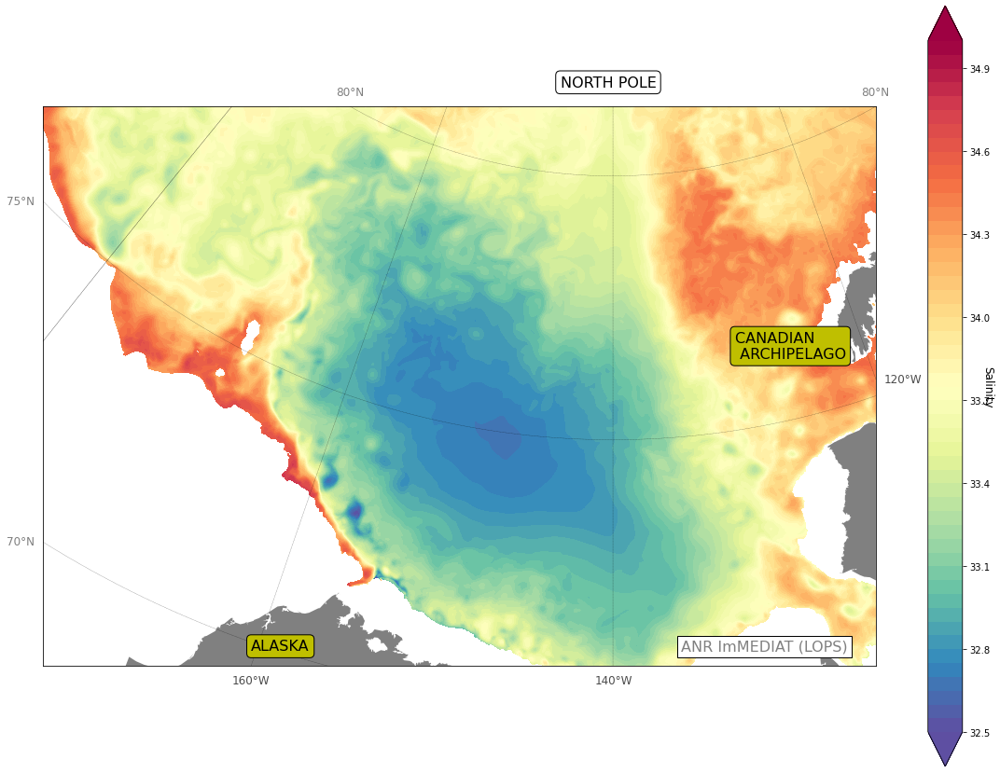

In [40]:
plt.clf()
vmin=32.5 ; vmax=35. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_S['nav_lon']),np.array(ds_alpha_S['nav_lat']), \
         #ds_alpha_S['vosaline'][0,54,:,:], contours, limits, zmap='Spectral_r',proj='cassi')
         xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1,np.nan,ds_alpha_S['vosaline'][0,54,:,:]), \
         contours, limits, zmap='Spectral_r',proj='cassis_BGZoom',fld='Salinity')

GeoBox(fig,area='zoom')

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_S_z181m_'+ext+'Zoom.png',dpi=250)

In [41]:
ds_alpha_T=xr.open_dataset(DATAIN+'SEDNA-ALPHA_y2003m06d23.1d_gridT_Z_SDOM-ARC.nc')

<Figure size 432x288 with 0 Axes>

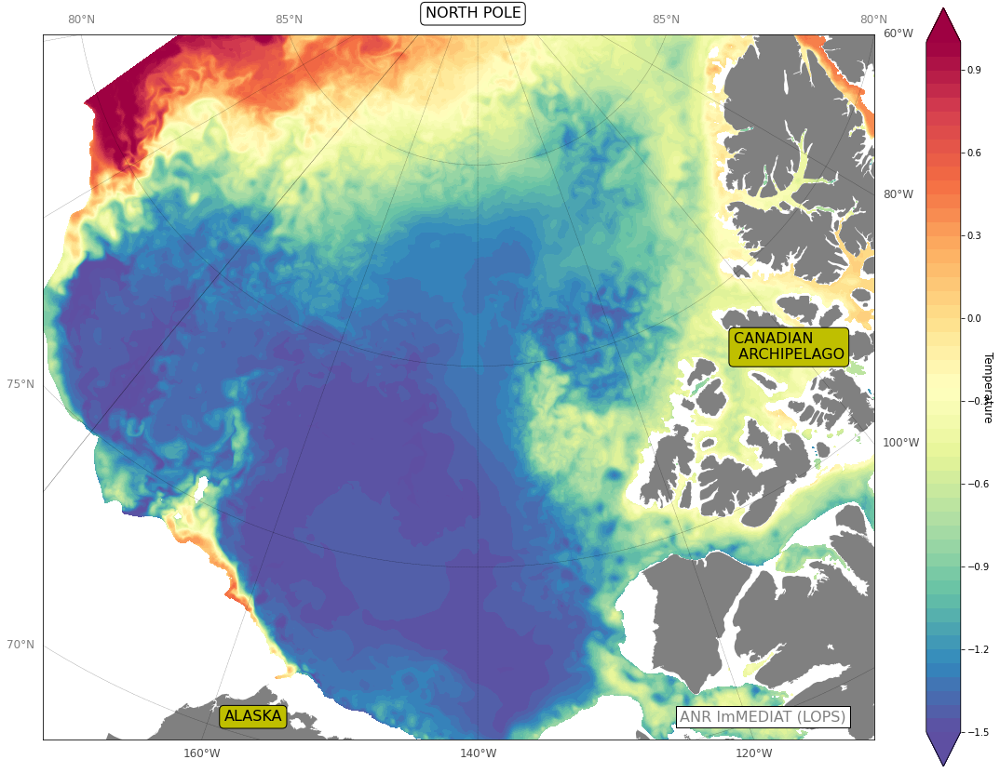

In [42]:
plt.clf()
vmin=-1.5 ; vmax=1. ; vint=0.05
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_T['nav_lon']),np.array(ds_alpha_T['nav_lat']), \
         xr.where(ds_alpha_S['vosaline'][0,54,:,:] <= 1.,np.nan,ds_alpha_T['votemper'][0,54,:,:]), \
         contours, limits, zmap='Spectral_r',proj='cassi',fld='Temperature')

GeoBox(fig)

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_T_z181m_'+ext+'.png',dpi=250)

In [43]:
ds_alpha_xiz181=xr.open_dataset(DATAIN+'SEDNA-ALPHA_y2004m06d23.1d_Xif_Z_lev54.nc')

<Figure size 432x288 with 0 Axes>

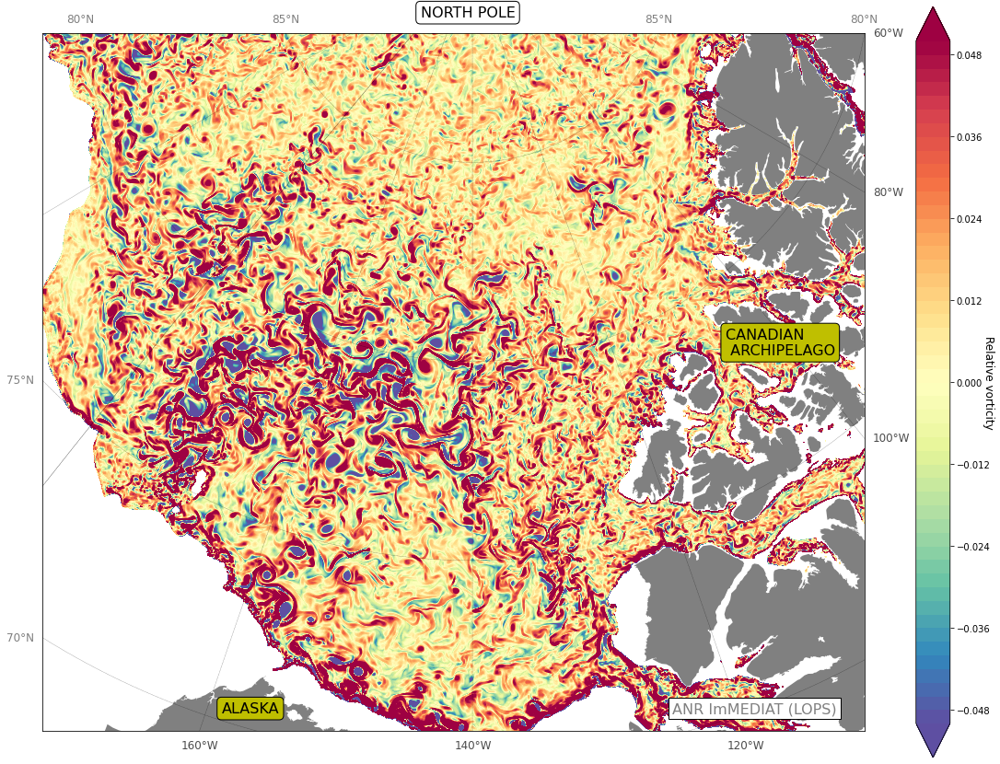

In [44]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='Spectral_r', \
         fld='Relative vorticity')

GeoBox(fig)

if mplot : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HR.pdf')

<Figure size 432x288 with 0 Axes>

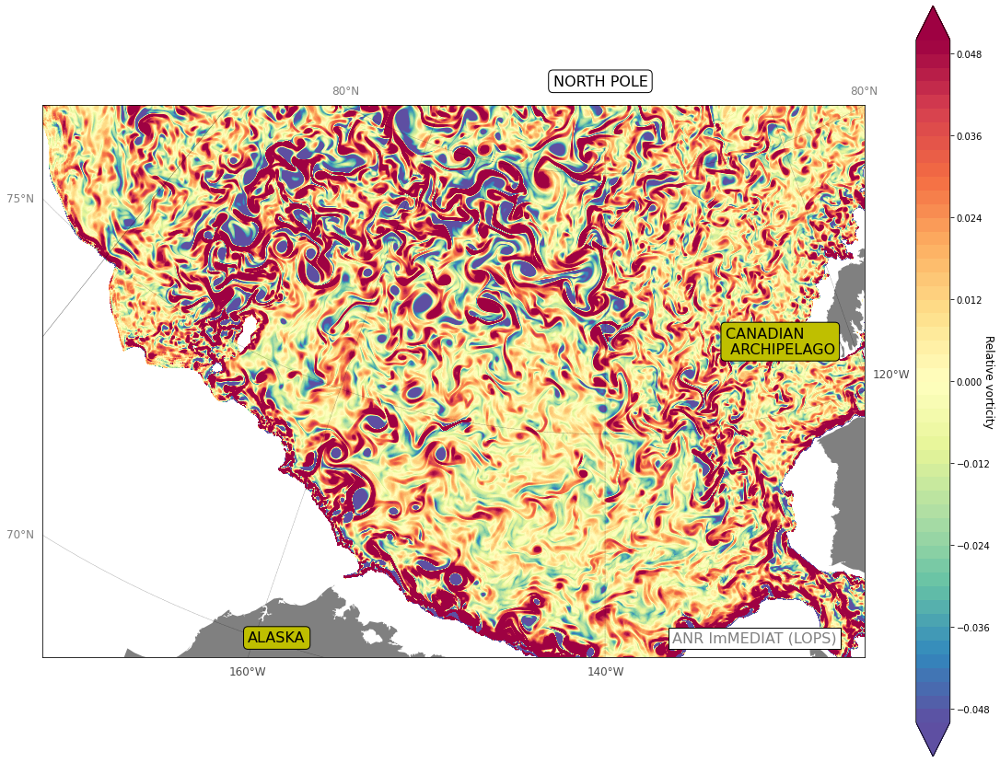

In [21]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='Spectral_r',\
         proj='cassis_BGZoom',fld='Relative vorticity')

GeoBox(fig,area='zoom')

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'Zoom.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HRZoomSpectral.png',dpi=700)

>> # As the previous plot but with a different color map

In [12]:
import matplotlib.image as mpimg
from matplotlib.offsetbox import OffsetImage,AnnotationBbox

In [13]:
lopslogo=mpimg.imread('./FIGURES/LOPS_logo.png')
imagebox=OffsetImage(lopslogo,zoom=0.2)
ab=AnnotationBbox(imagebox,(0.1,0.1),frameon=False)

<Figure size 432x288 with 0 Axes>

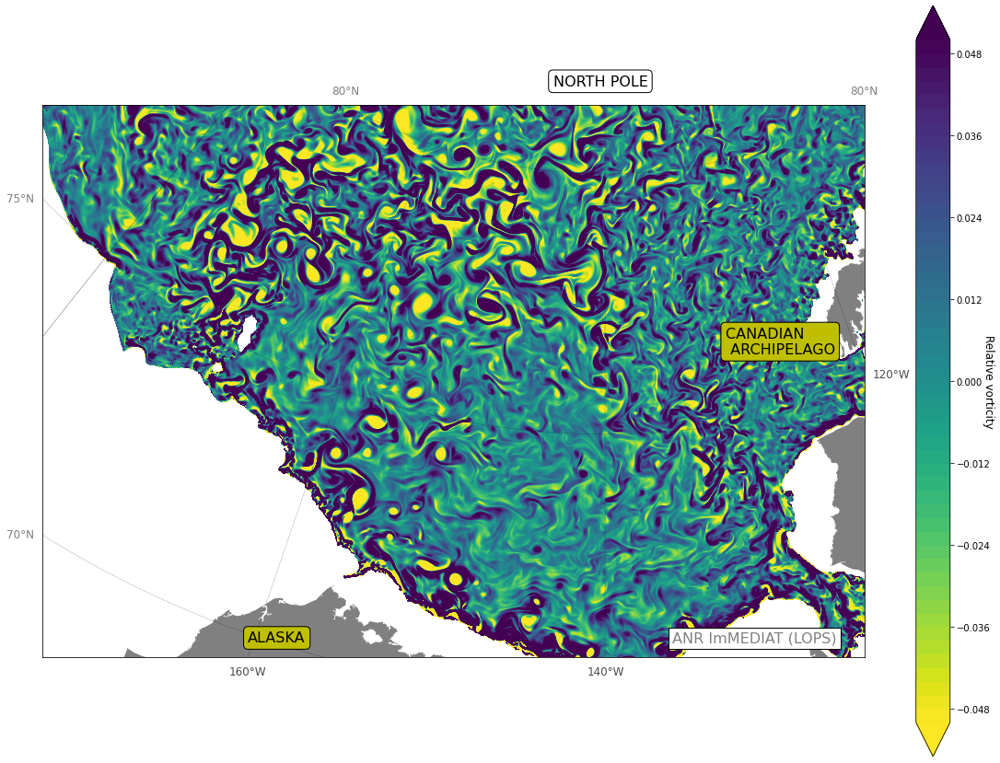

In [22]:
plt.clf()
vmin=-0.05 ; vmax=0.05 ; vint=0.002
contours=np.arange(vmin,vmax+vint,vint)
limits=[vmin,vmax]

fig=plt.figure(figsize=(20,15))
# OK but tiny fig, ax=plt.subplots()
#fig, ax=plt.figure(figsize=(20,15))
#fig, ax=plt.subplots(111)
plt.subplot(111)
Arc_plot(np.array(ds_alpha_xiz181['nav_lon']),np.array(ds_alpha_xiz181['nav_lat']), \
         ds_alpha_xiz181['socurloverf'][0,:,:], contours, limits, zmap='viridis_r', \
         proj='cassis_BGZoom',fld='Relative vorticity')

GeoBox(fig,area='zoom')
#fig, ax=plt.subplots()
#ax.add_artist(ab)

if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'Zoom.png',dpi=250)
if False : plt.savefig('./FIGURES/SEDNA-ALPHA_y2003m06d23_Xif_z181m_'+ext+'HRZoomViridis.png',dpi=700)